## Notebook Purpose
- This notebook is used to plot six panel SMB map figures used in the main text and supplementary material for the six glaciers considered in the study.
- It also presents number on mass conservation for slope-corrected Lagrangian measurements on all the six glaicers, and for Lagrangian SMB rates measurements for Black Changri Nup and Lirung Glacier

#### Last updated: August 14, 2023

## TODO:
- Update imports when new library has been built up with all updates
- Generalise path to data products during revisions, after the data distribution plan is finalized

In [2]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format='retina'
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
import matplotlib
matplotlib.rcParams.update(matplotlib.rcParamsDefault)
#matplotlib.rc('text', usetex=True)

#matplotlib.rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]

In [4]:
import numpy as np 
import geopandas as gpd
import matplotlib.pyplot as plt
from skimage import exposure
from imview import pltlib
import pandas as pd
from pygeotools.lib import warplib,geolib,iolib,malib,filtlib,timelib
import os,sys,glob,shutil
from velocity_proc import glac_dyn, constants, velocity_filter,velocity_timeseries
import warnings
warnings.filterwarnings('ignore')

In [5]:
%matplotlib inline

In [6]:
%cd /nobackup/sbhusha1/chapter2/HighresDebrisCover_SMB_Data/

/nobackupp11/sbhusha1/chapter2/HighresDebrisCover_SMB_Data


## 1. Imja Lhotse Shar

In [7]:
dem1_fn = 'ImjaLhotseShar/dem/20151002_0651_10200100457F0C00_1020010042C0CE00-DEM_2m.tif'
eul_fn = 'ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_eulerian_dhdt.tif'
lag_fn = 'ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_lagrangian_dhdt.tif'
slope_parallel_fn = 'ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_downslope_dhdt.tif'
smb_fn = 'ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_smb_dhdt.tif'
ortho_img_fn = '../imja/20230223/20151002_10200100457F0C00_ortho_proc/20151002_10200100457F0C00_ortho_res_2.0m.tif'
vx_fn = 'ImjaLhotseShar/SMB_data/20151002_combined_hs_masked__20161029_combined_hs_masked_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vx_skiprate_1_gauss_fill51px_shpclip_1.tif'
vy_fn = 'ImjaLhotseShar/SMB_data/20151002_combined_hs_masked__20161029_combined_hs_masked_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vy_skiprate_1_gauss_fill51px_shpclip_1.tif'
flux_div_fn = 'ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_divQ2.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['imja'])).to_crs('EPSG:32645')
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn,vx_fn,vy_fn,flux_div_fn],res='first',r='average')
dem1,eul,lag,slope_parallel,smb,ortho_img,vx,vy,divq2 = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[2])
vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,vx,ds_list[-3])
vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,vy,ds_list[-2])
#vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vx_ds),vx_ds)
#vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vy_ds),vy_ds)
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [492962.5, 3084915.0, 498337.5, 3092462.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 9: ImjaLhotseShar/dem/20151002_0651_10200100457F0C00_1020010042C0CE00-DEM_2m.tif
nl: 3774 ns: 2688 res: 2.000
0...10...20...30...40...50...60...70...80...90...2 of 9: ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_eulerian_dhdt.tif
nl: 3774 ns: 2688 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 9: ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_lagrangian_dhdt.tif
nl: 3774 ns: 2688 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 9: ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_downslope_dhdt.tif
nl: 3774 ns: 2688 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...5 of 9: ImjaLhotseShar/SMB_data/imja_farinotti_2015-10-02_to_2016-10-29_smb_dhdt.tif
nl: 3774 ns: 2

### Check for mass conservation in Lagrangian corrections

In [8]:
mask = malib.common_mask([lag,slope_parallel,smb])

In [9]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Imja Lhotse Shar Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Imja Lhotse Shar Glacier is 0.04 m/yr


In [10]:
pwd

'/nobackupp11/sbhusha1/chapter2/HighresDebrisCover_SMB_Data'

In [11]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 1297502,
 'min': -22.89774457216263,
 'max': 24.388204214428793,
 'ptp': 47.28594878659142,
 'mean': -0.8970504113815401,
 'std': 1.9675580086321884,
 'nmad': 1.1526557086167735,
 'med': -0.607441061322527,
 'median': -0.607441061322527,
 'p16': -2.0977745008062287,
 'p84': 0.4309161202046677,
 'spread': 1.2643453105054483,
 'mode': -10.05143666572055}

In [12]:
%matplotlib inline

In [13]:
def norm(a, perc_lim=(2, 98), clip=True, verbose=True):
    # Written and shared by David
    #Simple approach using actual min and max values
    #amin, amax = (a.min(), a.max())
    #Check if we're using masked array or np.nan
    if np.ma.isMaskedArray(a):
        amin, amax = np.percentile(a.compressed(), perc_lim)
    else:
        amin, amax = np.nanpercentile(a, perc_lim)
    out = ((a - amin)/(amax - amin))
    #This will "clip" normalized values <0 to 0 and >1 to 1
    if clip:
        out = out.clip(0,1)
    if verbose:
        print("Input range: ({}, {})".format(a.min(), a.max()))
        print(f"Percentile range {perc_lim}: ({amin}, {amax})")
        print("Output range: ({}, {})".format(out.min(), out.max()))
    return out

In [14]:
from matplotlib.colors import LogNorm

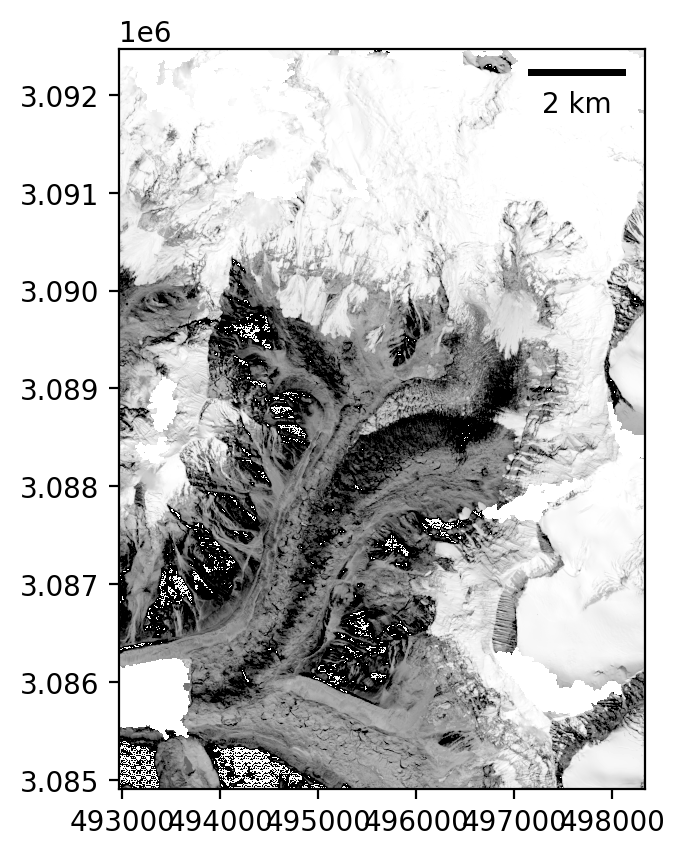

In [15]:
f,ax = plt.subplots()
im2 = ax.imshow(norm(ortho_img, verbose=False,perc_lim=(10,90)), cmap='gray', extent=fig_extent, norm=LogNorm(vmin=0.01, vmax=1))
pltlib.add_scalebar(ax,res=2,location='upper right')

In [24]:
copyright_text = r"$ \copyright$Maxar 2024"+"\n NextView/Enhanced View License"

Text(0.02, 0.5, '$ \\copyright$Maxar 2024\n NextView/Enhanced View License')

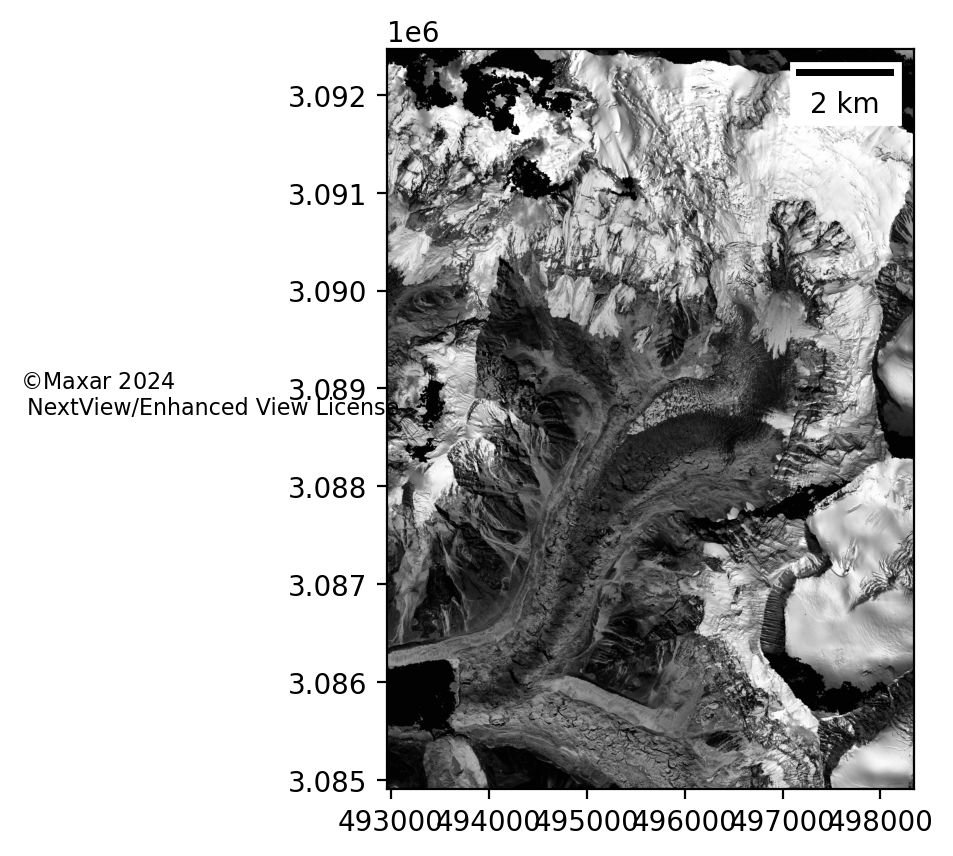

In [23]:
f,ax = plt.subplots()
#im2 = ax.imshow(norm(ortho_img, verbose=False,perc_lim=(10,90)), cmap='gray', extent=fig_extent, norm=LogNorm(vmin=0.01, vmax=1))
im2 = ax.imshow(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data), cmap='gray', extent=fig_extent)
pltlib.add_scalebar(ax,res=2,location='upper right')
plt.text(0.02, 0.5, text, fontsize=8, transform=plt.gcf().transFigure)


In [32]:
def add_quiver(ax, vx, vy, stride=10, color='dodgerblue',scale=5, quiver_key=True,
        quiver_key_units=20,quiver_key_unit_rep='m/yr',res=16,fig_extent=None):
    if fig_extent:
        X = np.arange(fig_extent[0],fig_extent[1],stride*2)
        Y = np.arange(fig_extent[3],fig_extent[2],-1*stride*2)
    else:
        X = np.arange(0,vx.shape[1],stride)
        Y = np.arange(0,vx.shape[0],stride)
    print(X.size,Y.size)
    
    Q = ax.quiver(X, Y, vx[::stride,::stride]*2, vy[::stride,::stride]*2, color=color,
     pivot='mid',units='xy',scale=scale,scale_units='xy')
    if quiver_key:
        if quiver_key_unit_rep == 'm/yr':
            label = f'{quiver_key_units}'+r'$\frac{m}{yr}$'
        elif quiver_key_unit_rep == 'm/day':
            label = f'{quiver_key_units}'+r'$\frac{m}{day}$'

        qk = ax.quiverkey(Q, 0.3, 1.02,U=quiver_key_units*scale*0.5, label=label, labelpos='E',
                   coordinates='axes')

In [73]:
fig_extent

[492962.5, 498338.5, 3084914.5, 3092462.5]

In [74]:
3092462.5-3084914.5

7548.0

In [75]:
(fig_extent[1]-fig_extent[0])/2

2688.0

In [76]:
vx.shape

(3774, 2688)

In [77]:
add_quiver(ax[2],vx,vy,stride=2,scale=5,color='black',quiver_key_units=30,quiver_key=False)


1344 1887


In [78]:
add_quiver(ax[2],vx,vy,stride=4,scale=5,color='black',quiver_key_units=30,quiver_key=False,fig_extent=fig_extent)

672 944


In [93]:
%matplotlib widget

42 59


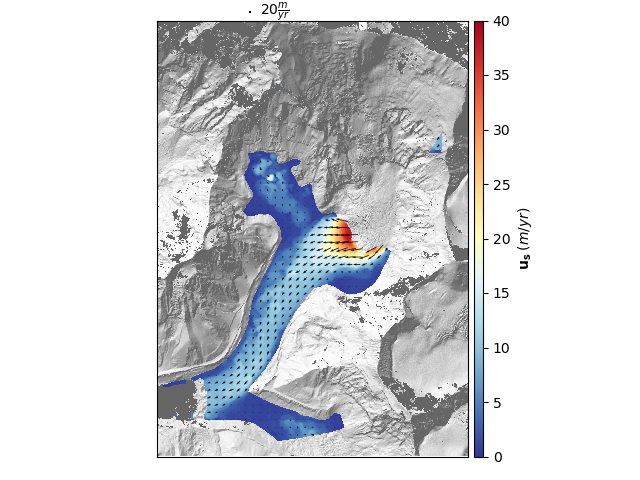

In [107]:
f,ax = plt.subplots()
pltlib.iv(np.ma.sqrt(vx**2+vy**2),ax=ax,cmap='RdYlBu_r',clim=(0,40),skinny=False,
           label=r'$\mathbf{u_{s}} \; (m/yr)$',hillshade=True,ds=ds_list[0],scalebar=False,
            full_bg_stretch=False,overlay_alpha=1,extent=fig_extent)
add_quiver(ax,vx,vy,stride=64,scale=0.25,color='black',fig_extent=fig_extent)

In [110]:
%matplotlib inline

42 59


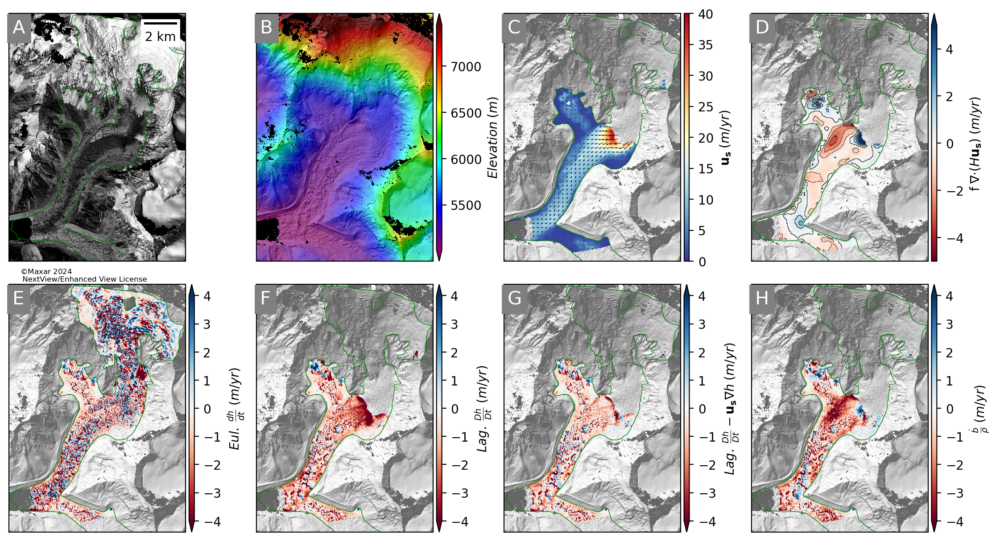

In [39]:
f,axa = plt.subplots(2,4,figsize=(11,8))
ax = axa.ravel()
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')

pltlib.iv(np.ma.sqrt(vx**2+vy**2),ax=ax[2],cmap='RdYlBu_r',clim=(0,40),skinny=False,
           label=r'$\mathbf{u_{s}} \; (m/yr)$',hillshade=True,ds=ds_list[0],scalebar=False,
            full_bg_stretch=False,overlay_alpha=1,extent=fig_extent)
add_quiver(ax[2],vx,vy,stride=64,scale=0.25,color='black',fig_extent=fig_extent,quiver_key=False)

pltlib.iv(divq2,ax=ax[3],cmap='RdBu',clim=(-5,5),skinny=False,label=r'$\mathrm{f}\;\nabla{\cdot}(H\mathbf{u_{s}})  \; (m/yr)$',hillshade=True,
          ds=ds_list[0],scalebar=False,extent=fig_extent,full_bg_stretch=False,overlay_alpha=1)
ax[3].contour(divq2,colors='k',linewidths=0.35,levels=np.arange(-5,5).tolist(),extent=contour_extent)

pltlib.iv(eul,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[6],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[7],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

t = ax[6].text(0.020,0.92,'G',
    color='white', fontsize=15,transform=ax[6].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[7].text(0.020,0.92,'H',
    color='white', fontsize=15,transform=ax[7].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
plt.text(0.01, 0.488, copyright_text, fontsize=6, transform=plt.gcf().transFigure)
plt.tight_layout()

f.savefig('../figures/imja_smb_300_8panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

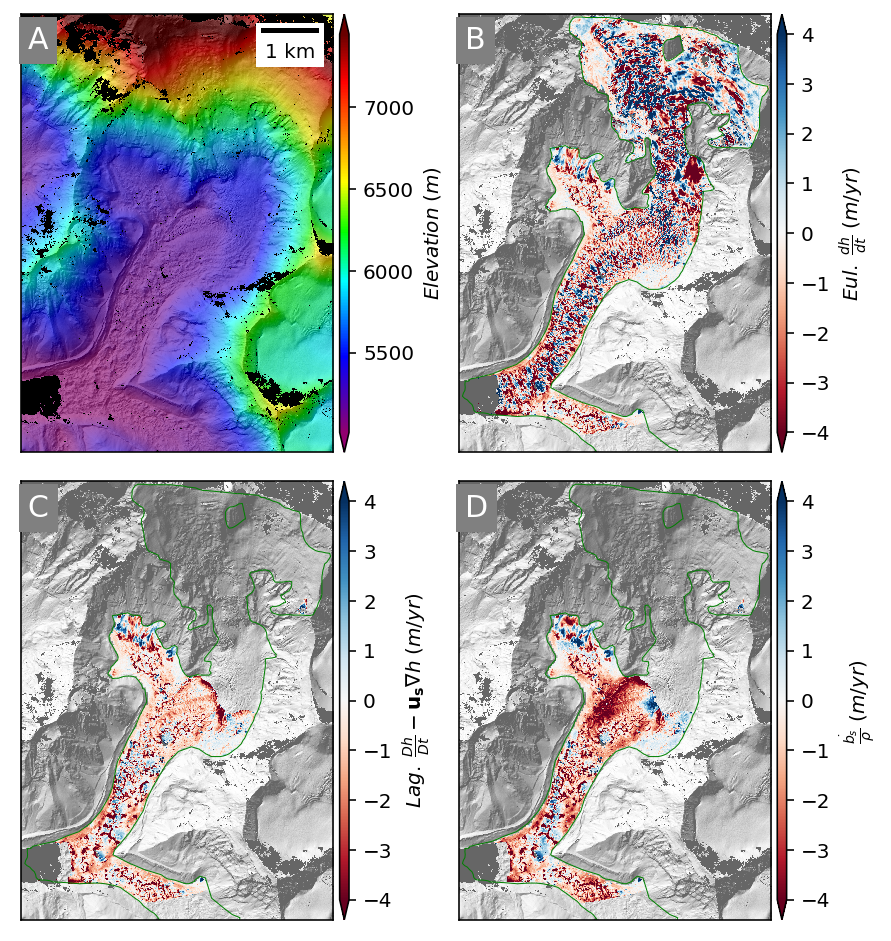

In [12]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(fig_extent[0],fig_extent[1])
        ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/imja_smb_300.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

In [18]:
ls /nobackupp11/sbhusha1/chapter2/figures/

SMB_maps.ipynb                   khumbu_vel_fluxdiv.png
blackchangrinup_vel_fluxdiv.png  langtang_vel_fluxdiv.png
imja_smb.png                     lirung_vel_fluxdiv.png
imja_vel_fluxdiv.png             ngozumpa_vel_fluxdiv.png


## 2. Ngozumpa

In [40]:
dem1_fn = 'Ngozumpa/dem/20121223_0456_1050410000E0AE00_1050410000E8C900-DEM_2m.tif'
eul_fn = 'Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_eulerian_dhdt.tif'
lag_fn = 'Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lagrangian_dhdt.tif'
slope_parallel_fn = 'Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_downslope_dhdt.tif'
smb_fn = 'Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_smb_dhdt.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['ngozumpa'])).to_crs('EPSG:32645')
ortho_img_fn = '../ngozumpa/20230217/orthoimage/20121223_1050410000E0AE00_ortho_res_2.0m.tif'
vx_fn = 'Ngozumpa/SMB_data/20121223_combined_hs__20150115_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vx_skiprate_1_gauss_fill51px_shpclip.tif'
vy_fn = 'Ngozumpa/SMB_data/20121223_combined_hs__20150115_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vy_skiprate_1_gauss_fill51px_shpclip.tif'
flux_div_fn = 'Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_divQ2.tif'
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn,vx_fn,vy_fn,flux_div_fn],res='first',r='average')
#ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img,vx,vy,divq2 = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[2])
vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,vx,ds_list[-3])
vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,vy,ds_list[-2])
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [466125.0, 3089921.0, 476775.0, 3104071.0]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 9: Ngozumpa/dem/20121223_0456_1050410000E0AE00_1050410000E8C900-DEM_2m.tif
nl: 7075 ns: 5325 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 9: Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_eulerian_dhdt.tif
nl: 7075 ns: 5325 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 9: Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lagrangian_dhdt.tif
nl: 7075 ns: 5325 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 9: Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_downslope_dhdt.tif
nl: 7075 ns: 5325 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...5 of 9: Ngozumpa/SMB_data/ngozumpa_farinotti_2012-12-23_to_2015-01-15_smb_dhdt.tif
nl: 7075 ns: 532

### Check for mass conservation in Lagrangian corrections

In [41]:
mask = malib.common_mask([lag,slope_parallel,smb])

In [42]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Ngozumpa Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Ngozumpa Glacier is 0.02 m/yr


In [43]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Ngozumpa Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Ngozumpa Glacier is 0.02 m/yr


In [24]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 4836160,
 'min': -20.983572006225586,
 'max': 13.9563627243042,
 'ptp': 34.93993377685547,
 'mean': -0.9928499712888856,
 'std': 2.428074885369728,
 'nmad': 1.5506663439273833,
 'med': -0.6570096611976624,
 'median': -0.6570096611976624,
 'p16': -2.877673864364624,
 'p84': 0.7498531341552734,
 'spread': 1.8137634992599487,
 'mode': -0.4680068790912628}

In [25]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 4848713,
 'min': -19.530142750856335,
 'max': 15.491026280885674,
 'ptp': 35.021169031742005,
 'mean': -1.0121452407669693,
 'std': 1.6004616555672995,
 'nmad': 1.0410651011657457,
 'med': -0.7114875143712973,
 'median': -0.7114875143712973,
 'p16': -2.1479545343634614,
 'p84': 0.15683324738238677,
 'spread': 1.152393890872924,
 'mode': -1.563964583128097}

84 111


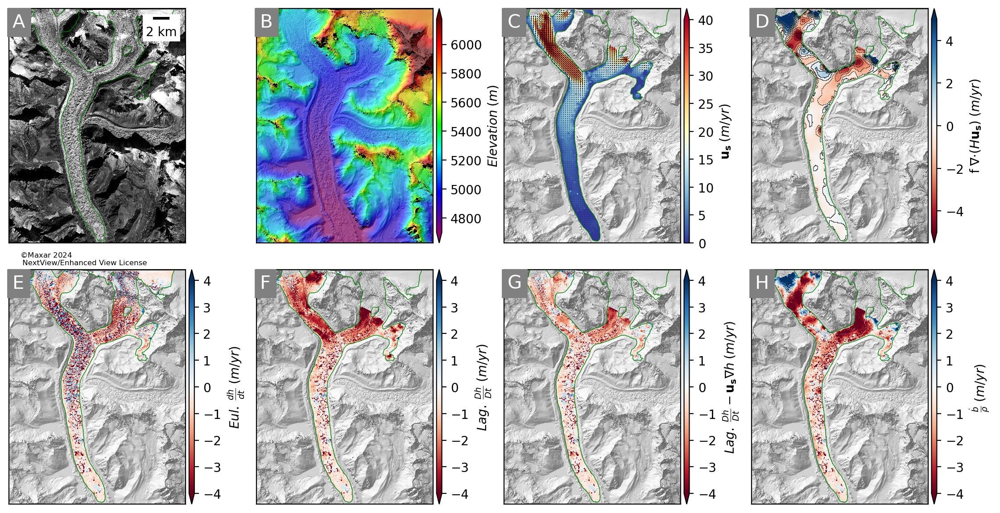

In [44]:
f,axa = plt.subplots(2,4,figsize=(11,8))
ax = axa.ravel()
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')

pltlib.iv(np.ma.sqrt(vx**2+vy**2),ax=ax[2],cmap='RdYlBu_r',clim=(0,40),skinny=False,
           label=r'$\mathbf{u_{s}} \; (m/yr)$',hillshade=True,ds=ds_list[0],scalebar=False,
            full_bg_stretch=False,overlay_alpha=1,extent=fig_extent)
add_quiver(ax[2],vx,vy,stride=64,scale=0.25,color='black',fig_extent=fig_extent,quiver_key=False)

pltlib.iv(divq2,ax=ax[3],cmap='RdBu',clim=(-5,5),skinny=False,label=r'$\mathrm{f}\;\nabla{\cdot}(H\mathbf{u_{s}})  \; (m/yr)$',hillshade=True,
          ds=ds_list[0],scalebar=False,extent=fig_extent,full_bg_stretch=False,overlay_alpha=1)
ax[3].contour(divq2,colors='k',linewidths=0.35,levels=np.arange(-5,5).tolist(),extent=contour_extent)

pltlib.iv(eul,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[6],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[7],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

t = ax[6].text(0.020,0.92,'G',
    color='white', fontsize=15,transform=ax[6].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[7].text(0.020,0.92,'H',
    color='white', fontsize=15,transform=ax[7].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
plt.text(0.01, 0.488, copyright_text, fontsize=6, transform=plt.gcf().transFigure)
plt.tight_layout()

f.savefig('../figures/ngozumpa_smb_300_8panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

## 3. Black Changri Nup 

In [47]:
ls BlackChangriNup/SMB_data

20151102_combined_hs__20161025_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vm_skiprate_1_gauss_fill51px_shpclip_b1.tif
20151102_combined_hs__20161025_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vx_skiprate_1_gauss_fill51px_shpclip_b1.tif
20151102_combined_hs__20161025_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vy_skiprate_1_gauss_fill51px_shpclip_b1.tif
black_changri_nup_farinotti_2015-11-02_to_2016-10-25_altitudnal_meltcurve.png
black_changri_nup_farinotti_2015-11-02_to_2016-10-25_altitudnal_meltstats.csv
black_changri_nup_farinotti_2015-11-02_to_2016-10-25_divQ2.tif
black_changri_nup_farinotti_2015-11-02_to_2016-10-25_downslope_dhdt.tif
black_changri_nup_farinotti_2015-11-02_to_2016-10-25_eulerian_dhdt.tif
black_changri_nup_farinotti_2015-11-02_to_2016-10-25_hotspot_location.gpkg
black_changri_nup_farinotti_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif
black_changri_nup_farinotti_2015-11-02_to_2016-10-25_slope_corrected_lagrangian

In [48]:
dem1_fn = 'BlackChangriNup/dem/20151102_0517_10400100125E8E00_10400100130D8500_align.tif'
eul_fn = 'BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_eulerian_dhdt.tif'
lag_fn = 'BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif'
slope_parallel_fn = 'BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_downslope_dhdt.tif'
smb_fn = 'BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_smb_dhdt.tif'
glac_shp = gpd.read_file('/nobackup/sbhusha1/hma/agu22_scratch/Black_changri_with_accumulation_area2.shp')
ortho_img_fn = '../changrinup/20230217/orthoimage/20151102_10400100125E8E00_ortho_res_2.0m.tif'
vx_fn = 'BlackChangriNup/SMB_data/20151102_combined_hs__20161025_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vx_skiprate_1_gauss_fill51px_shpclip_b1.tif'
vy_fn = 'BlackChangriNup/SMB_data/20151102_combined_hs__20161025_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vy_skiprate_1_gauss_fill51px_shpclip_b1.tif'
flux_div_fn = 'BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_divQ2.tif'
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn,vx_fn,vy_fn,flux_div_fn],res='first',r='average')
#ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img,vx,vy,divq2 = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[2])
vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,vx,ds_list[-3])
vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,vy,ds_list[-2])
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [476612.5, 3094162.5, 482987.5, 3099437.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 9: BlackChangriNup/dem/20151102_0517_10400100125E8E00_10400100130D8500_align.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 9: BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_eulerian_dhdt.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 9: BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 9: BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_downslope_dhdt.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...5 of 9: BlackChangriNup/SMB_data/black_changr

In [15]:
dem1_fn = 'changrinup/20151102_aligned/20151102_aligned-trans_source-DEM.tif'
eul_fn = 'changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_eulerian_dhdt.tif'
lag_fn = 'changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif'
slope_parallel_fn = 'changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_downslope_dhdt.tif'
smb_fn = 'changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_smb_dhdt.tif'
ortho_img_fn = 'changrinup/20230217/orthoimage/20151102_10400100125E8E00_ortho_res_2.0m.tif'
glac_shp = gpd.read_file('/nobackup/sbhusha1/hma/agu22_scratch/Black_changri_with_accumulation_area2.shp') 
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,ortho_img_fn,smb_fn],res='last',r='cubic')

dem1,eul,lag,slope_parallel,ortho_img,smb = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[1])
#vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vx_ds),vx_ds)
#vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vy_ds),vy_ds)
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [476612.5, 3094162.5, 482987.5, 3099437.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: cubic

1 of 6: changrinup/20151102_aligned/20151102_aligned-trans_source-DEM.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 6: changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_eulerian_dhdt.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 6: changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 6: changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_downslope_dhdt.tif
nl: 2638 ns: 3

### Check for mass conservation in Lagrangian corrections

In [49]:
mask = malib.common_mask([lag,slope_parallel,smb])

In [50]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 532488,
 'min': -20.05634880065918,
 'max': 17.4743709564209,
 'ptp': 37.53071975708008,
 'mean': -0.5841925207882982,
 'std': 1.7789022909756582,
 'nmad': 0.8785365156054497,
 'med': -0.5368327498435974,
 'median': -0.5368327498435974,
 'p16': -1.6040844917297363,
 'p84': 0.3427983224391937,
 'spread': 0.973441407084465,
 'mode': -0.382962703704834}

In [51]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 532488,
 'min': -20.05634880065918,
 'max': 17.4743709564209,
 'ptp': 37.53071975708008,
 'mean': -0.5841925207882982,
 'std': 1.7789022909756582,
 'nmad': 0.8785365156054497,
 'med': -0.5368327498435974,
 'median': -0.5368327498435974,
 'p16': -1.6040844917297363,
 'p84': 0.3427983224391937,
 'spread': 0.973441407084465,
 'mode': -0.382962703704834}

In [52]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 532499,
 'min': -18.14466470783417,
 'max': 17.431885826781386,
 'ptp': 35.576550534615556,
 'mean': -0.5918645677425957,
 'std': 1.508417855165054,
 'nmad': 0.7015687543419208,
 'med': -0.5280944121817518,
 'median': -0.5280944121817518,
 'p16': -1.3869143654626512,
 'p84': 0.15423404871721302,
 'spread': 0.7705742070899322,
 'mode': -0.6434732551793939}

In [53]:
malib.get_stats_dict(np.ma.array(smb,mask=mask))

{'count': 532499,
 'min': -18.242136776031735,
 'max': 17.598088060669543,
 'ptp': 35.84022483670128,
 'mean': -0.6147033107320204,
 'std': 1.8590934462738855,
 'nmad': 0.9635527918738283,
 'med': -0.6898371146119601,
 'median': -0.6898371146119601,
 'p16': -1.7002596668262364,
 'p84': 0.3166294779160807,
 'spread': 1.0084445723711586,
 'mode': 2.52748211271548}

In [54]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Black Changri Nup Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Black Changri Nup Glacier is 0.01 m/yr


In [55]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Black Changri Nup Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Black Changri Nup Glacier is 0.01 m/yr


In [56]:
slope_corrected_lag_smb_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(smb,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and Lag. SMB for Black Changri Nup Glacier is {np.round(slope_corrected_lag_smb_conservation,2)} m/yr")

Difference between Eul. dh/dt and Lag. SMB for Black Changri Nup Glacier is 0.03 m/yr


In [57]:
slope_corrected_lag_smb_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(smb,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and Lag. SMB for Black Changri Nup Glacier is {np.round(slope_corrected_lag_smb_conservation,2)} m/yr")

Difference between Eul. dh/dt and Lag. SMB for Black Changri Nup Glacier is 0.03 m/yr


In [60]:
! apply_mask.py BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_smb_dhdt.tif /nobackupp11/sbhusha1/hma/lagdz_samples/debris_thickness/HMA_DTE_15.03734_hdts_m.tif

Warping mask_fn

Warping all inputs to the following:
Resolution: 2.0
Extent: [474665.0, 3090517.0, 488435.0, 3100917.0]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: cubic

1 of 1: /nobackupp11/sbhusha1/hma/lagdz_samples/debris_thickness/HMA_DTE_15.03734_hdts_m.tif
nl: 5200 ns: 6885 res: 2.000
0...10...20...30...40...50...60...70...80...90...100 - done.
Loading mask array
Extracting mask
Loading src array and applying updated mask
Writing out masked version of input raster: BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_smb_dhdt_masked.tif


In [61]:
! robust_stats.py BlackChangriNup/SMB_data/black_changri_nup_farinotti_2015-11-02_to_2016-10-25_smb_dhdt_masked.tif

/swbuild/sbhusha1/conda/install/envs/bhushangdal3/lib/python3.11/site-packages/osgeo/gdal.py:287: FutureWarning: Neither gdal.UseExceptions() nor gdal.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(
Count: 286436
RMSE: 1.742
Mean Error: -1.178
Standard Deviation: 1.283
Median Error: -0.978
16th Percentile: -1.902
84th Percentile: -0.266
Spread: 1.636
Absolute Median Error: 0.989
NMAD: 0.798
68.3th Percentile: 1.395
95th Percentile: 3.280


In [62]:
constants.fetch_rounce_debris_thickness('changri_nup')

'/nobackupp11/sbhusha1/hma/lagdz_samples/debris_thickness/HMA_DTE_15.03734_hdts_m.tif'

In [63]:
%matplotlib inline

50 42


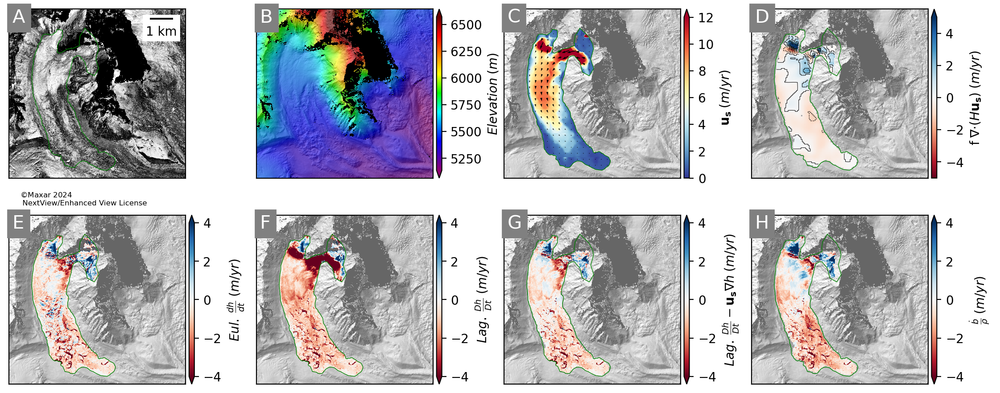

In [65]:
f,axa = plt.subplots(2,4,figsize=(11,8))
ax = axa.ravel()
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')

pltlib.iv(np.ma.sqrt(vx**2+vy**2),ax=ax[2],cmap='RdYlBu_r',clim=(0,12),skinny=False,
           label=r'$\mathbf{u_{s}} \; (m/yr)$',hillshade=True,ds=ds_list[0],scalebar=False,
            full_bg_stretch=False,overlay_alpha=1,extent=fig_extent)
add_quiver(ax[2],vx,vy,stride=64,scale=0.25,color='black',fig_extent=fig_extent,quiver_key=False)

pltlib.iv(divq2,ax=ax[3],cmap='RdBu',clim=(-5,5),skinny=False,label=r'$\mathrm{f}\;\nabla{\cdot}(H\mathbf{u_{s}})  \; (m/yr)$',hillshade=True,
          ds=ds_list[0],scalebar=False,extent=fig_extent,full_bg_stretch=False,overlay_alpha=1)
ax[3].contour(divq2,colors='k',linewidths=0.35,levels=np.arange(-5,5).tolist(),extent=contour_extent)

pltlib.iv(eul,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[6],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[7],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(477599.7040301451, 481379.6298482157)
    ax.set_ylim(3094811.880500241, 3098430.95841116)
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(477599.7040301451, 481379.6298482157)
    ax.set_ylim(3094811.880500241, 3098430.95841116)
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

t = ax[6].text(0.020,0.92,'G',
    color='white', fontsize=15,transform=ax[6].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[7].text(0.020,0.92,'H',
    color='white', fontsize=15,transform=ax[7].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
plt.text(0.01, 0.488, copyright_text, fontsize=6, transform=plt.gcf().transFigure)
plt.tight_layout()
f.savefig('../figures/blackchangrinup_smb_300_8panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(5,6))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='Elevation (m)')
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label=r'$\frac{dh}{dt}$'+' (m/yr)')
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label=r'$\frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h}$'+' (m/yr)')
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label=r'$\frac{\dot{b}}{\rho}$'+' (m i.e./yr)')
linewidth = 1
for ax in axa.ravel():

    glac_shp.plot(ax=ax,facecolor='None',edgecolor='black',linewidth=linewidth)
    ax.set_xlim(477599.7040301451, 481379.6298482157)
    ax.set_ylim(3094811.880500241, 3098430.95841116)
plt.tight_layout()
f.savefig('figures/blackchangri_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

In [42]:
ax.get_xlim()

(477599.7040301451, 481379.6298482157)

In [43]:
ax.get_ylim()

(3094811.880500241, 3098430.95841116)

## 4. Khumbu

In [66]:
dem1_fn = 'Khumbu/dem/20151102_0517_10400100125E8E00_10400100130D8500_align.tif'
eul_fn = 'Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_eulerian_dhdt.tif'
lag_fn = 'Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif'
slope_parallel_fn = 'Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_downslope_dhdt.tif'
smb_fn = 'Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_smb_dhdt.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['khumbu'])).to_crs('EPSG:32645')
ortho_img_fn = '../changrinup/20230217/orthoimage/20151102_10400100125E8E00_ortho_res_2.0m.tif'
vx_fn = 'Khumbu/SMB_data/20151102_combined_hs__20161025_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vx_skiprate_1_gauss_fill51px_shpclip_b1.tif'
vy_fn = 'Khumbu/SMB_data/20151102_combined_hs__20161025_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vy_skiprate_1_gauss_fill51px_shpclip_b1.tif'
flux_div_fn = 'Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_divQ2.tif'
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn,vx_fn,vy_fn,flux_div_fn],res='first',r='average')
#ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img,vx,vy,divq2 = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[2])
vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,vx,ds_list[-3])
vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,vy,ds_list[-2])
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [481512.5, 3090519.0, 488435.0, 3099662.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 9: Khumbu/dem/20151102_0517_10400100125E8E00_10400100130D8500_align.tif
nl: 4572 ns: 3461 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 9: Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_eulerian_dhdt.tif
nl: 4572 ns: 3461 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 9: Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif
nl: 4572 ns: 3461 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 9: Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_downslope_dhdt.tif
nl: 4572 ns: 3461 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...5 of 9: Khumbu/SMB_data/khumbu_farinotti_2015-11-02_to_2016-10-25_smb_dhdt.tif
nl: 4572 ns: 3461 res: 2.000
100 - 

### Check for mass conservation in Lagrangian corrections

In [67]:
mask = malib.common_mask([lag,slope_parallel,smb])


In [68]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Khumbu Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Khumbu Glacier is 0.09 m/yr


In [69]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Khumbu Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Khumbu Glacier is 0.09 m/yr


In [70]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 2055457,
 'min': -33.217228583840885,
 'max': 21.28681106029126,
 'ptp': 54.50403964413215,
 'mean': -1.1010661295867403,
 'std': 1.9992843012216983,
 'nmad': 1.3056905957417169,
 'med': -0.7708853596858039,
 'median': -0.7708853596858039,
 'p16': -2.4538420783853567,
 'p84': 0.3101329976089596,
 'spread': 1.3819875379971582,
 'mode': -12.911811504488355}

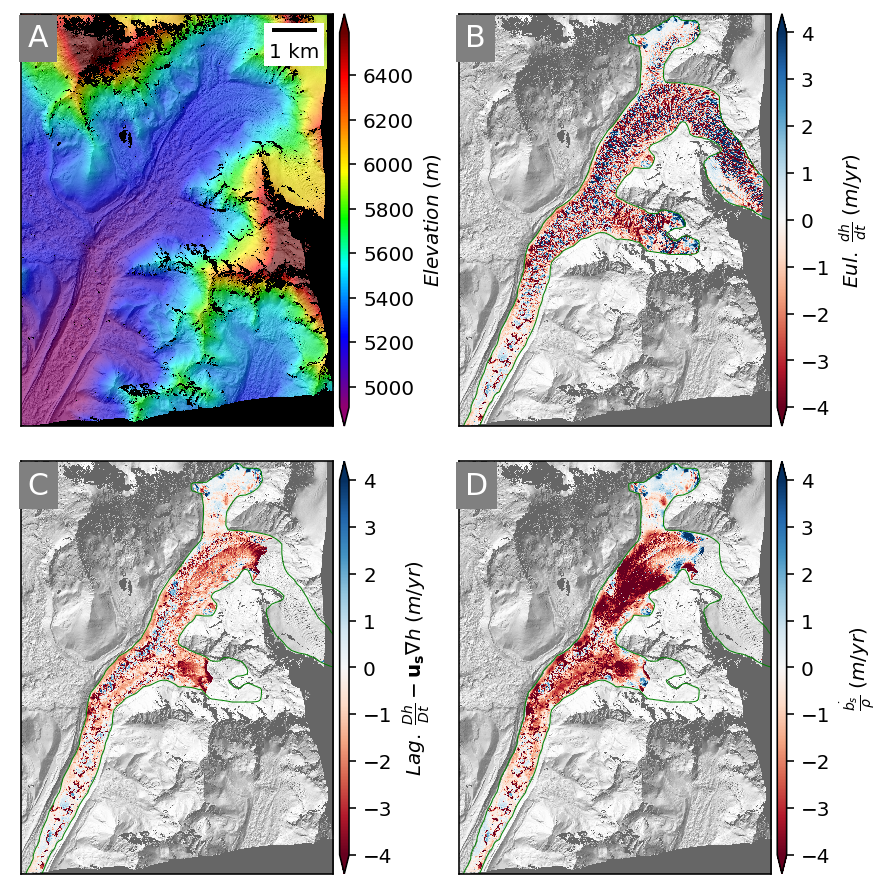

In [39]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(fig_extent[0],fig_extent[1])
        ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/khumbu_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

55 72


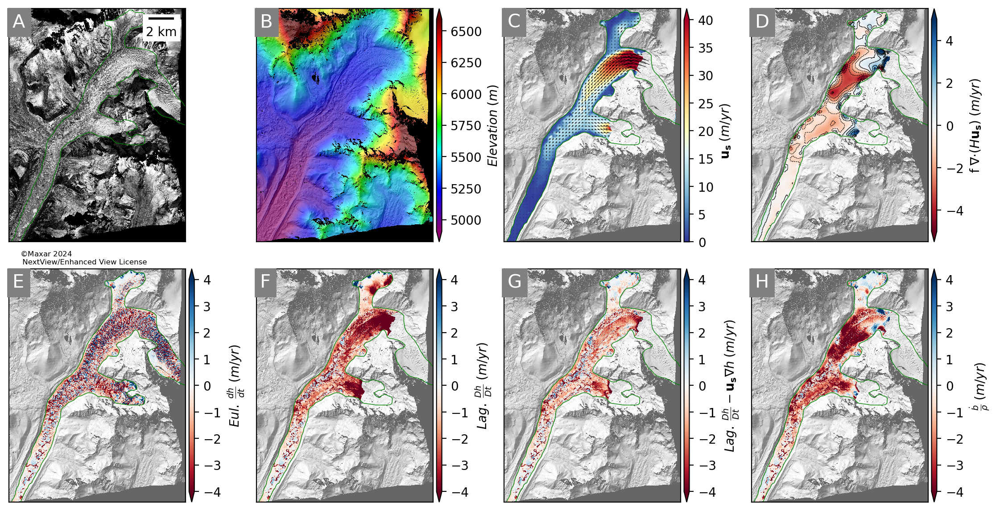

In [72]:
f,axa = plt.subplots(2,4,figsize=(11,8))
ax = axa.ravel()
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')

pltlib.iv(np.ma.sqrt(vx**2+vy**2),ax=ax[2],cmap='RdYlBu_r',clim=(0,40),skinny=False,
           label=r'$\mathbf{u_{s}} \; (m/yr)$',hillshade=True,ds=ds_list[0],scalebar=False,
            full_bg_stretch=False,overlay_alpha=1,extent=fig_extent)
add_quiver(ax[2],vx,vy,stride=64,scale=0.25,color='black',fig_extent=fig_extent,quiver_key=False)

pltlib.iv(divq2,ax=ax[3],cmap='RdBu',clim=(-5,5),skinny=False,label=r'$\mathrm{f}\;\nabla{\cdot}(H\mathbf{u_{s}})  \; (m/yr)$',hillshade=True,
          ds=ds_list[0],scalebar=False,extent=fig_extent,full_bg_stretch=False,overlay_alpha=1)
ax[3].contour(divq2,colors='k',linewidths=0.35,levels=np.arange(-5,5).tolist(),extent=contour_extent)

pltlib.iv(eul,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[6],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[7],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

t = ax[6].text(0.020,0.92,'G',
    color='white', fontsize=15,transform=ax[6].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[7].text(0.020,0.92,'H',
    color='white', fontsize=15,transform=ax[7].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
plt.text(0.01, 0.488, copyright_text, fontsize=6, transform=plt.gcf().transFigure)
plt.tight_layout()
f.savefig('../figures/khumbu_smb_300_8panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

## 5. Langtang

In [73]:
dem1_fn = 'Langtang/dem/20150222_0504_1040010008B92D00_10400100087E2400-DEM_2m_align.tif'
eul_fn = 'Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_eulerian_dhdt.tif'
lag_fn = 'Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_lagrangian_dhdt.tif'
slope_parallel_fn = 'Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_downslope_dhdt.tif'
smb_fn = 'Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_smb_dhdt.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['langtang'])).to_crs('EPSG:32645')
ortho_img_fn = '../langtang/20230223/orthoimage/20160107_103001004E783B00_ortho_res_2.0m.tif'
vx_fn = 'Langtang/SMB_data/20150222_combined_hs__20160107_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vx_skiprate_1_gauss_fill51px_shpclip_1.tif'
vy_fn = 'Langtang/SMB_data/20150222_combined_hs__20160107_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vy_skiprate_1_gauss_fill51px_shpclip_1.tif'
flux_div_fn = 'Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_divQ2.tif'
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn,vx_fn,vy_fn,flux_div_fn],res='first',r='average')
#ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img,vx,vy,divq2 = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[2])
vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,vx,ds_list[-3])
vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,vy,ds_list[-2])
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [368087.5, 3121737.5, 375912.5, 3139937.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 9: Langtang/dem/20150222_0504_1040010008B92D00_10400100087E2400-DEM_2m_align.tif
nl: 9100 ns: 3912 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 9: Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_eulerian_dhdt.tif
nl: 9100 ns: 3912 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 9: Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_lagrangian_dhdt.tif
nl: 9100 ns: 3912 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 9: Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_downslope_dhdt.tif
nl: 9100 ns: 3912 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...5 of 9: Langtang/SMB_data/langtang_farinotti_2015-02-22_to_2016-01-07_smb_dhdt.tif
nl: 9100 n

### Check for mass conservation in Lagrangian corrections

In [74]:
mask = malib.common_mask([eul,lag,slope_parallel,smb])

In [75]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Langtang Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Langtang Glacier is 0.01 m/yr


In [76]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Langtang Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Langtang Glacier is 0.01 m/yr


In [77]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 6129546,
 'min': -37.09577941894531,
 'max': 45.41825866699219,
 'ptp': 82.5140380859375,
 'mean': -1.1688589215725615,
 'std': 2.891870471698131,
 'nmad': 1.6746340387344358,
 'med': -0.8677420020103455,
 'median': -0.8677420020103455,
 'p16': -3.023993968963623,
 'p84': 0.6246876120567322,
 'spread': 1.8243407905101776,
 'mode': -0.46626195311546326}

In [78]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 6129546,
 'min': -42.57486742359738,
 'max': 45.445063131547606,
 'ptp': 88.01993055514498,
 'mean': -1.1803975352860643,
 'std': 2.514197330184267,
 'nmad': 1.331106274011967,
 'med': -0.8561135733168854,
 'median': -0.8561135733168854,
 'p16': -2.6990610109339856,
 'p84': 0.26235827309162785,
 'spread': 1.4807096420128067,
 'mode': -24.240208045611787}

In [79]:
malib.get_stats_dict(np.ma.array(smb,mask=mask))

{'count': 6129546,
 'min': -39.05461743599665,
 'max': 44.938645439839995,
 'ptp': 83.99326287583665,
 'mean': -1.366637383637938,
 'std': 2.977562100602499,
 'nmad': 1.7857438420340308,
 'med': -0.9824483971676525,
 'median': -0.9824483971676525,
 'p16': -3.564100510350603,
 'p84': 0.5395941194960393,
 'spread': 2.051847314923321,
 'mode': -26.65960441372266}

In [84]:
copyright_text_langtang = r"$ \copyright$Maxar 2024"+"\n NextView/Enhanced"+ "\nView License"

62 143


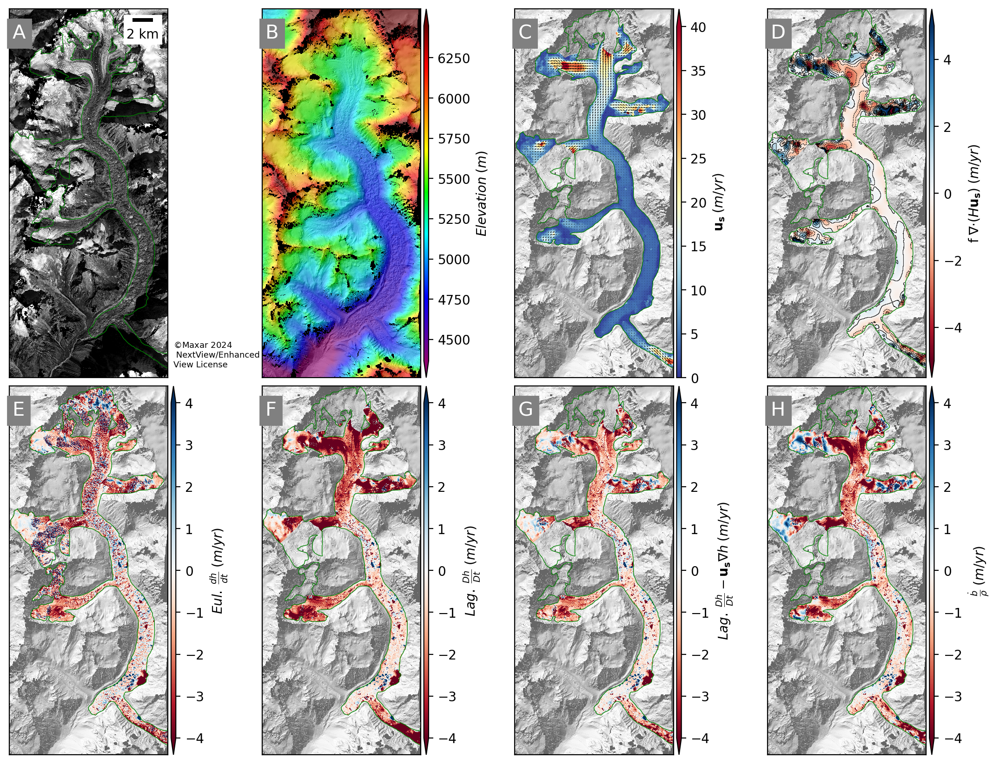

In [88]:
f,axa = plt.subplots(2,4,figsize=(11,8))
ax = axa.ravel()
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')

pltlib.iv(np.ma.sqrt(vx**2+vy**2),ax=ax[2],cmap='RdYlBu_r',clim=(0,40),skinny=False,
           label=r'$\mathbf{u_{s}} \; (m/yr)$',hillshade=True,ds=ds_list[0],scalebar=False,
            full_bg_stretch=False,overlay_alpha=1,extent=fig_extent)
add_quiver(ax[2],vx,vy,stride=64,scale=0.25,color='black',fig_extent=fig_extent,quiver_key=False)

pltlib.iv(divq2,ax=ax[3],cmap='RdBu',clim=(-5,5),skinny=False,label=r'$\mathrm{f}\;\nabla{\cdot}(H\mathbf{u_{s}})  \; (m/yr)$',hillshade=True,
          ds=ds_list[0],scalebar=False,extent=fig_extent,full_bg_stretch=False,overlay_alpha=1)
ax[3].contour(divq2,colors='k',linewidths=0.35,levels=np.arange(-5,5).tolist(),extent=contour_extent)

pltlib.iv(eul,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[6],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[7],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

t = ax[6].text(0.020,0.92,'G',
    color='white', fontsize=15,transform=ax[6].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[7].text(0.020,0.92,'H',
    color='white', fontsize=15,transform=ax[7].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
plt.text(0.19, 0.52, copyright_text_langtang, fontsize=6.5, transform=plt.gcf().transFigure)
plt.tight_layout()
f.savefig('../figures/langtang_smb_300_8panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

## 6. Lirung

In [89]:
dem1_fn = 'Lirung/dem/20161106_0456_103001005FAB7A00_103001005F7EBB00-DEM_2m_align.tif'
eul_fn = 'Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_eulerian_dhdt.tif'
lag_fn = 'Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_lagrangian_dhdt.tif'
slope_parallel_fn = 'Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_downslope_dhdt.tif'
smb_fn = 'Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_smb_dhdt.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['lirung'])).to_crs('EPSG:32645')
ortho_img_fn = '../lirung/202320218/ortho2m/20161106_103001005FAB7A00_ortho_res_2.0m.tif'
vx_fn = 'Lirung/SMB_data/20161106_combined_hs__20171222_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vx_skiprate_1_1_masked_gauss_fill51px_1.tif'
vy_fn = 'Lirung/SMB_data/20161106_combined_hs__20171222_combined_hs_mgm_disp_9spm_spm_ker15_corr_kernel9px_resmin_txm_vy_skiprate_1_1_masked_gauss_fill51px_1.tif'
flux_div_fn = 'Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_divQ2.tif'
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn,vx_fn,vy_fn,flux_div_fn],res='first',r='average')
#ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img,vx,vy,divq2 = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[2])
vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,vx,ds_list[-3])
vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,vy,ds_list[-2])
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [357337.5, 3122712.5, 359212.5, 3126237.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 9: Lirung/dem/20161106_0456_103001005FAB7A00_103001005F7EBB00-DEM_2m_align.tif
nl: 1762 ns: 938 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 9: Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_eulerian_dhdt.tif
nl: 1762 ns: 938 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 9: Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_lagrangian_dhdt.tif
nl: 1762 ns: 938 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 9: Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_downslope_dhdt.tif
nl: 1762 ns: 938 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...5 of 9: Lirung/SMB_data/lirung_farinotti_2016-11-06_to_2017-12-22_smb_dhdt.tif
nl: 1762 ns: 938 res: 2.000
100 

### Check for mass conservation in Lagrangian corrections

In [90]:
mask = malib.common_mask([lag,slope_parallel,smb])

In [91]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Lirung Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Lirung Glacier is 0.04 m/yr


In [92]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Lirung Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Lirung Glacier is 0.04 m/yr


In [93]:
slope_corrected_lag_smb_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(smb,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and Lag. SMB for Lirung Glacier is {np.round(slope_corrected_lag_smb_conservation,2)} m/yr")

Difference between Eul. dh/dt and Lag. SMB for Lirung Glacier is 0.16 m/yr


In [94]:
slope_corrected_lag_smb_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(smb,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and Lag. SMB for Lirung Glacier is {np.round(slope_corrected_lag_smb_conservation,2)} m/yr")

Difference between Eul. dh/dt and Lag. SMB for Lirung Glacier is 0.16 m/yr


In [95]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 318981,
 'min': -26.267566680908203,
 'max': 18.867589950561523,
 'ptp': 45.135154724121094,
 'mean': -2.0068776517204054,
 'std': 2.6448879555248825,
 'nmad': 1.2622333513498305,
 'med': -0.9444395303726196,
 'median': -0.9444395303726196,
 'p16': -4.31858434677124,
 'p84': -0.14190316200256348,
 'spread': 2.088340592384338,
 'mode': -0.2651534080505371}

In [96]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 319031,
 'min': -26.399727245193297,
 'max': 16.94026386725601,
 'ptp': 43.33999111244931,
 'mean': -2.0469416607289412,
 'std': 2.6122694013855843,
 'nmad': 1.2413356418785129,
 'med': -0.9526829873708034,
 'median': -0.9526829873708034,
 'p16': -4.325913036371484,
 'p84': -0.17488648784468264,
 'spread': 2.075513274263401,
 'mode': -0.9051321406827166}

In [97]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']

0.040064009008535795

In [98]:
malib.get_stats_dict(np.ma.array(smb,mask=mask))

{'count': 319031,
 'min': -26.953767625250528,
 'max': 17.885191386686326,
 'ptp': 44.83895901193685,
 'mean': -2.1655578581098283,
 'std': 2.8062899036364817,
 'nmad': 1.188402082605274,
 'med': -1.0318251665275087,
 'median': -1.0318251665275087,
 'p16': -4.6850505159330424,
 'p84': -0.24634649648132467,
 'spread': 2.219352009725859,
 'mode': -13.412197595844091}

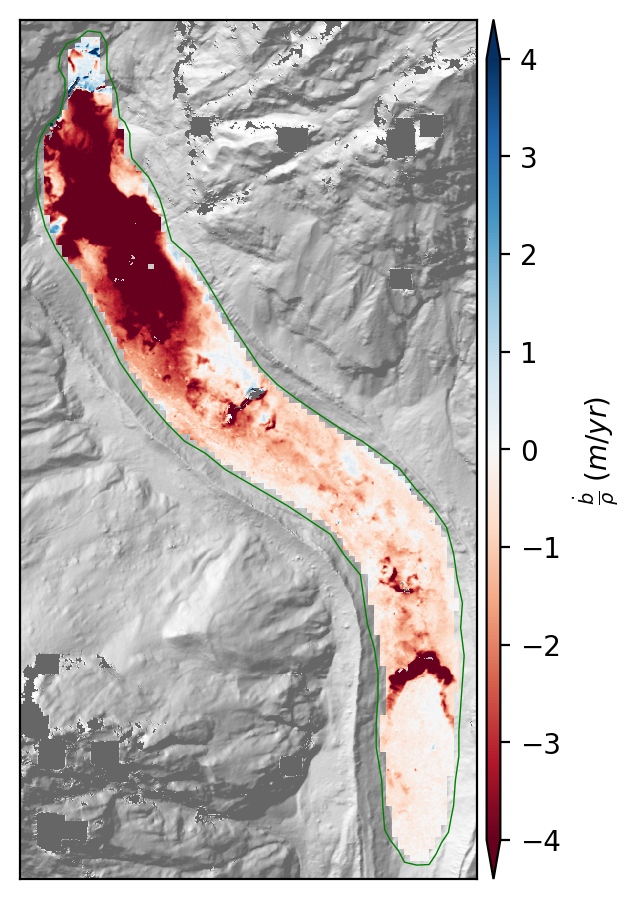

In [24]:
f,ax = plt.subplots(figsize=(3,6))
pltlib.iv(smb,ax=ax,cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
           
linewidth = 0.5

ax.set_xlim(fig_extent[0],fig_extent[1])
ax.set_ylim(fig_extent[2],fig_extent[3])
    
glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
ax.set_xlim(fig_extent[0],fig_extent[1])
ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
f.savefig('figures/lirung_smb_only.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

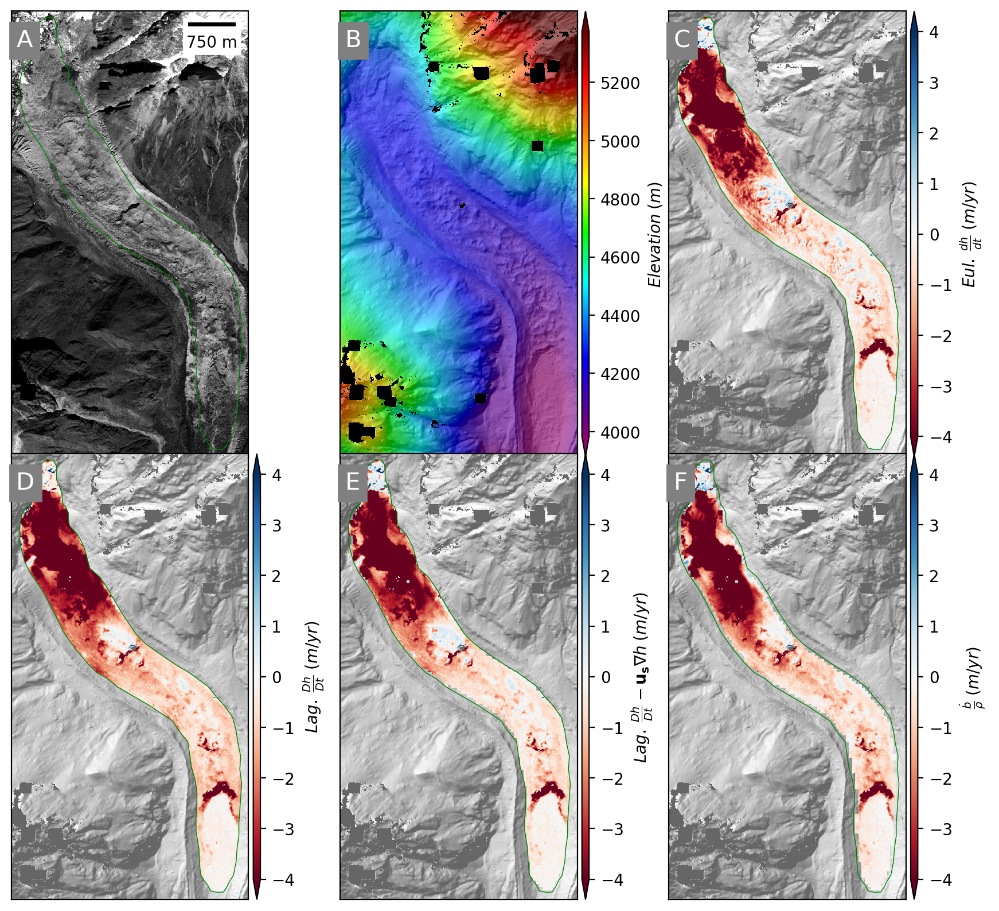

In [25]:
f,axa = plt.subplots(2,3,sharex=True,sharey=True,figsize=(8.5,8))
ax = axa.ravel()
#pltlib.iv(ortho_img,ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False,clim=malib.calcperc(ortho_img,(0,80)))
#im2 = ax[0].imshow(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data), cmap='gray', extent=fig_extent)
#ax[0].set_xticks([])
#ax[0].set_yticks([])
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False,perc_lim=(0,100)).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')
pltlib.iv(eul,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

f.savefig('figures/lirung_smb_300_6panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

In [ ]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(fig_extent[0],fig_extent[1])
        ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/lirung_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

15 28


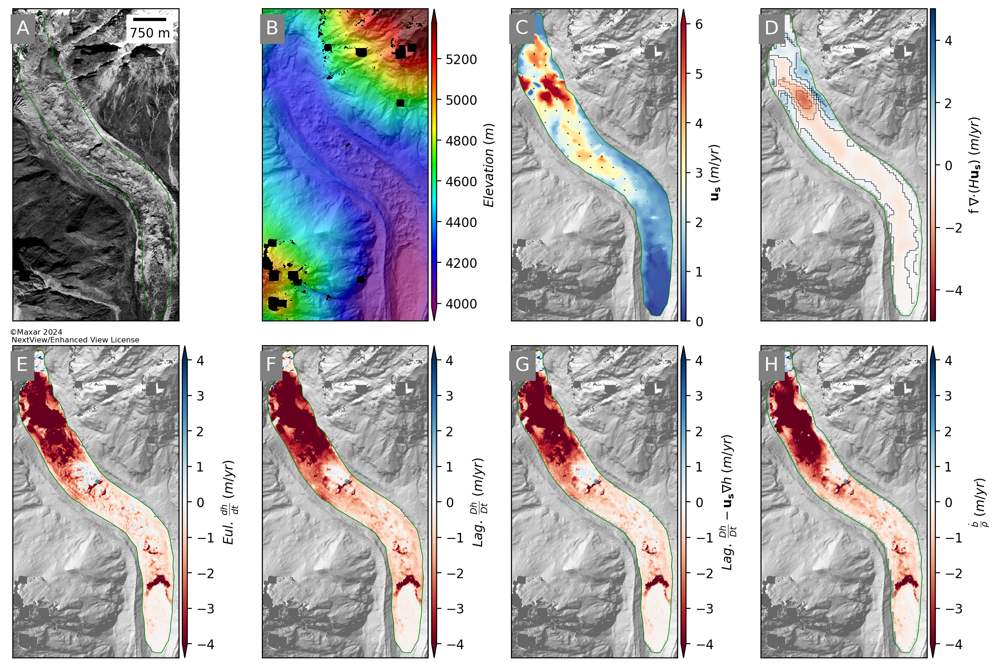

In [101]:
f,axa = plt.subplots(2,4,figsize=(11,8))
ax = axa.ravel()
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')

pltlib.iv(np.ma.sqrt(vx**2+vy**2),ax=ax[2],cmap='RdYlBu_r',clim=(0,6),skinny=False,
           label=r'$\mathbf{u_{s}} \; (m/yr)$',hillshade=True,ds=ds_list[0],scalebar=False,
            full_bg_stretch=False,overlay_alpha=1,extent=fig_extent)
add_quiver(ax[2],vx,vy,stride=64,scale=0.25,color='black',fig_extent=fig_extent,quiver_key=False)

pltlib.iv(divq2,ax=ax[3],cmap='RdBu',clim=(-5,5),skinny=False,label=r'$\mathrm{f}\;\nabla{\cdot}(H\mathbf{u_{s}})  \; (m/yr)$',hillshade=True,
          ds=ds_list[0],scalebar=False,extent=fig_extent,full_bg_stretch=False,overlay_alpha=1)
ax[3].contour(divq2,colors='k',linewidths=0.35,levels=np.arange(-5,5).tolist(),extent=contour_extent)

pltlib.iv(eul,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[6],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[7],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{b}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

t = ax[6].text(0.020,0.92,'G',
    color='white', fontsize=15,transform=ax[6].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[7].text(0.020,0.92,'H',
    color='white', fontsize=15,transform=ax[7].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
#
plt.tight_layout()
plt.text(0.01, 0.488, copyright_text, fontsize=6, transform=plt.gcf().transFigure)
f.savefig('../figures/lirung_smb_300_8panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)